# Visualizing Embedding Spaces using Plotly

In [ ]:
# from dash import Dash, html, dcc, callback, Output, Input
import plotly.express as px
import pandas as pd
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from shapely.geometry import box
import stackstac
from box import Box
import planetary_computer
from pystac_client import Client
import xarray as xr
import numpy as np
import torch
from rasterio.warp import transform_bounds
from upath import UPath
from torchvision.transforms import v2
from torch.utils.data import DataLoader
from terratorch.models.backbones.prithvi_vit import _create_prithvi, default_cfgs, PRETRAINED_BANDS, load_model_config_from_hf
from terratorch.datasets.utils import HLSBands

from dataset.prithvi import PrithviDataset
from utils.zarr import save_to_zarr
from utils.raster import concat_band

# catalog
collection = "sentinel-2-l2a"
pystac_client = Client.open("https://planetarycomputer.microsoft.com/api/stac/v1", modifier=planetary_computer.sign_inplace)
# Data Config
BANDS = ["B02", "B03", "B04", "B8A", "B11", "B12"]
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
METADATA_PATH = "/code/scaleai/fine_tuning/configs/metadata.yaml"

Error in cpuinfo: prctl(PR_SVE_GET_VL) failed
/usr/local/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


wxc_downscaling not installed


Let's define an AOI over the dates of a large forst fire

In [2]:
# Area over Monchique Portugal
AOI = box(*(-8.586577406216064, 37.29779935453866, -8.557558179814784, 37.320978903275964))
start_date = "2018-07-01"
end_date = "2018-09-01"

Let's retrieve the data from Microsoft Planetary - note here that we do not rescale the data, and instead will use the Prithvi teams' normalization values later on.

In [3]:
search_result = pystac_client.search(
    collections=[collection],
    intersects=AOI,
    datetime=f"{start_date}T00:00:00Z/{end_date}T23:59:59Z",
    query={"eo:cloud_cover": {"lt": 80}}
)
items = search_result.get_items()

data = stackstac.stack(
    list(items),
    assets=BANDS,
    bounds_latlon=AOI.bounds,
    rescale=False,
)
data

/usr/local/lib/python3.10/site-packages/pystac_client/item_search.py:881: FutureWarning: get_items() is deprecated, use items() instead
  warnings.warn(


<xarray.DataArray 'stackstac-0b2642967e5661b0c31b5f754a9eb77e' (time: 12,
                                                                band: 6,
                                                                y: 260, x: 260)> Size: 39MB
dask.array<fetch_raster_window, shape=(12, 6, 260, 260), dtype=float64, chunksize=(1, 1, 260, 260), chunktype=numpy.ndarray>
Coordinates: (12/44)
  * time                                     (time) datetime64[ns] 96B 2018-0...
    id                                       (time) <U54 3kB 'S2B_MSIL2A_2018...
  * band                                     (band) <U3 72B 'B02' ... 'B12'
  * x                                        (x) float64 2kB 5.366e+05 ... 5....
  * y                                        (y) float64 2kB 4.131e+06 ... 4....
    platform                                 (time) <U11 528B 'Sentinel-2B' ....
    ...                                       ...
    gsd                                      (band) float64 48B 10.0 ... 20.0
    proj:bbox                                object 8B {4090200.0, 4200000.0,...
    common_name                              (band) <U7 168B 'blue' ... 'swir22'
    center_wavelength                        (band) float64 48B 0.49 ... 2.19
    full_width_half_max                      (band) float64 48B 0.098 ... 0.242
    epsg                                     int64 8B 32629
Attributes:
    spec:        RasterSpec(epsg=32629, bounds=(536620.0, 4127980.0, 539220.0...
    crs:         epsg:32629
    transform:   | 10.00, 0.00, 536620.00|\n| 0.00,-10.00, 4130580.00|\n| 0.0...
    resolution:  10.0

Clip to our AOI

In [4]:
left, bottom, right, top = AOI.bounds
bounds_proj = transform_bounds(src_crs="EPSG:4326", dst_crs=data.rio.crs, left=left, bottom=bottom, right=right, top=top)

clipped_data = data.rio.clip_box(*bounds_proj)
clipped_data = clipped_data[...,:224,:224]
clipped_data.load()

<xarray.DataArray 'stackstac-0b2642967e5661b0c31b5f754a9eb77e' (time: 12,
                                                                band: 6,
                                                                y: 224, x: 224)> Size: 29MB
array([[[[9080., 8848., 8960., ..., 4108., 3388., 3142.],
         [9288., 9072., 9168., ..., 4340., 3684., 3098.],
         [9504., 9544., 9656., ..., 4132., 3286., 2906.],
         ...,
         [ 841.,  803.,  874., ...,  803.,  879.,  711.],
         [ 823.,  808.,  674., ...,  904.,  973.,  828.],
         [ 888.,  866.,  612., ...,  774.,  935.,  900.]],

        [[8344., 8360., 8240., ..., 4288., 3646., 3084.],
         [8552., 8576., 8592., ..., 4488., 3740., 3074.],
         [8816., 8952., 9040., ..., 4360., 3392., 2898.],
         ...,
         [ 999.,  963.,  863., ...,  979., 1094., 1068.],
         [ 951.,  974.,  763., ..., 1064., 1168., 1122.],
         [ 923.,  968.,  758., ..., 1036., 1226., 1266.]],

        [[7912., 8096., 7916., ..., 4420., 3660., 3112.],
         [8120., 8336., 8336., ..., 4628., 3790., 3100.],
         [8424., 8664., 8760., ..., 4460., 3466., 2868.],
         ...,
...
         ...,
         [1254., 1508., 1508., ..., 3523., 3523., 3371.],
         [1254., 1508., 1508., ..., 3523., 3523., 3371.],
         [1248., 1242., 1242., ..., 3359., 3359., 3125.]],

        [[ 854.,  858.,  858., ..., 1827., 1827., 1912.],
         [ 803.,  834.,  834., ..., 1682., 1682., 1850.],
         [ 803.,  834.,  834., ..., 1682., 1682., 1850.],
         ...,
         [1796., 1846., 1846., ..., 2669., 2669., 2961.],
         [1796., 1846., 1846., ..., 2669., 2669., 2961.],
         [1840., 1782., 1782., ..., 2166., 2166., 2298.]],

        [[ 356.,  344.,  344., ..., 1827., 1827., 1936.],
         [ 321.,  336.,  336., ..., 1499., 1499., 1739.],
         [ 321.,  336.,  336., ..., 1499., 1499., 1739.],
         ...,
         [1658., 1562., 1562., ..., 1611., 1611., 1647.],
         [1658., 1562., 1562., ..., 1611., 1611., 1647.],
         [1672., 1662., 1662., ..., 1136., 1136., 1360.]]]])
Coordinates: (12/45)
  * time                                     (time) datetime64[ns] 96B 2018-0...
    id                                       (time) <U54 3kB 'S2B_MSIL2A_2018...
  * band                                     (band) <U3 72B 'B02' ... 'B12'
  * x                                        (x) float64 2kB 5.366e+05 ... 5....
  * y                                        (y) float64 2kB 4.131e+06 ... 4....
    platform                                 (time) <U11 528B 'Sentinel-2B' ....
    ...                                       ...
    proj:bbox                                object 8B {4090200.0, 4200000.0,...
    common_name                              (band) <U7 168B 'blue' ... 'swir22'
    center_wavelength                        (band) float64 48B 0.49 ... 2.19
    full_width_half_max                      (band) float64 48B 0.098 ... 0.242
    epsg                                     int64 8B 32629
    spatial_ref                              int64 8B 0
Attributes:
    spec:        RasterSpec(epsg=32629, bounds=(536620.0, 4127980.0, 539220.0...
    resolution:  10.0

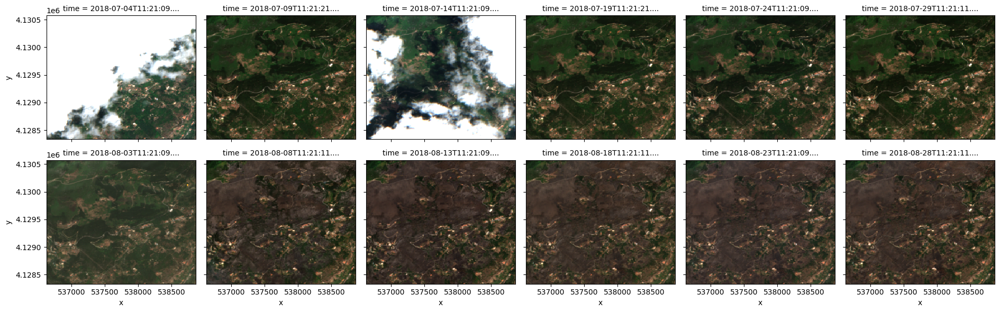

In [5]:
rgb = clipped_data.sel(band=["B04", "B03", "B02"])
rgb.plot.imshow(
    row="time", rgb="band", vmin=0, vmax=3000, col_wrap=6, cmap="terrain"
)

#### 1. Analyze the Embedding Space Representations for Cloudy/Clear Scenes.

In [6]:
PRITHVI_MODEL_VARIANT = "prithvi_vit_100"
DATASET_PATH = "/scratch/cloud_clear"
cloudy_image = clipped_data.isel(time=0).expand_dims("time")
clear_image = clipped_data.isel(time=1).expand_dims("time")

Save the datacubes to Zarr

In [8]:
def drop_coords(data: xr.DataArray):
    for coord in data.coords:
        if coord not in ["time", "band", "x", "y", "spatial_ref", "proj:epsg", "epsg"]:
            data = data.drop_vars(coord)
    return data

cloudy_image = drop_coords(cloudy_image)
clear_image = drop_coords(clear_image)
labelled_before = concat_band(cloudy_image, np.zeros(np.expand_dims(cloudy_image[:,0,:,:], 1).shape), band_names=["label"], dims=["time","band","x","y"])
save_to_zarr(labelled_before, UPath(DATASET_PATH).joinpath("cloudy.zarr"))
labelled_after = concat_band(clear_image, np.ones(np.expand_dims(clear_image[:,0,:,:],1).shape), band_names=["label"], dims=["time","band","x","y"])
save_to_zarr(labelled_after, UPath(DATASET_PATH).joinpath("clear.zarr"))

In [9]:
def get_prithvi_model(prithvi_model_variant: str, num_frames: int):
    config, *_ = load_model_config_from_hf(default_cfgs[prithvi_model_variant].default.hf_hub_id)

    config.update(num_frames=num_frames)
    config.update(features_only=True)

    model =  _create_prithvi(
        variant=PRITHVI_MODEL_VARIANT,
        pretrained=True,
        pretrained_bands=PRETRAINED_BANDS,
        model_bands=[HLSBands.BLUE, HLSBands.GREEN, HLSBands.RED, HLSBands.NIR_NARROW, HLSBands.SWIR_1, HLSBands.SWIR_2],
        **config
    )
    
    return model, config

In [10]:
model, config = get_prithvi_model(prithvi_model_variant=PRITHVI_MODEL_VARIANT, num_frames=1)
model

PrithviViT(
  (patch_embed): PatchEmbed(
    (proj): Conv3d(6, 768, kernel_size=(1, 16, 16), stride=(1, 16, 16))
    (norm): Identity()
  )
  (blocks): ModuleList(
    (0-11): 12 x Block(
      (norm1): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
      (attn): Attention(
        (qkv): Linear(in_features=768, out_features=2304, bias=True)
        (q_norm): Identity()
        (k_norm): Identity()
        (attn_drop): Dropout(p=0.0, inplace=False)
        (proj): Linear(in_features=768, out_features=768, bias=True)
        (proj_drop): Dropout(p=0.0, inplace=False)
      )
      (ls1): Identity()
      (drop_path1): Identity()
      (norm2): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
      (mlp): Mlp(
        (fc1): Linear(in_features=768, out_features=3072, bias=True)
        (act): GELU(approximate='none')
        (drop1): Dropout(p=0.0, inplace=False)
        (norm): Identity()
        (fc2): Linear(in_features=3072, out_features=768, bias=True)
        (drop2): D

In [11]:
metadata={"sentinel-2-l2a": {"bands": {"mean": {}, "std": {}}}}

for idx, b in enumerate(BANDS):
    metadata["sentinel-2-l2a"]["bands"]["mean"].update({b: config["mean"][idx]})
    metadata["sentinel-2-l2a"]["bands"]["std"].update({b: config["std"][idx]})


dataset = PrithviDataset(
    chip_dir=DATASET_PATH,
    metadata=Box(metadata)
)

Found 2 chips to process for /scratch/cloud_clear


In [12]:
metadata

{'sentinel-2-l2a': {'bands': {'mean': {'B02': 775.2290211032589,
    'B03': 1080.992780391705,
    'B04': 1228.5855250417867,
    'B8A': 2497.2022620507532,
    'B11': 2204.2139147975554,
    'B12': 1610.8324823273745},
   'std': {'B02': 1281.526139861424,
    'B03': 1270.0297974547493,
    'B04': 1399.4802505642526,
    'B8A': 1368.3446143747644,
    'B11': 1291.6764008585435,
    'B12': 1154.505683480695}}}}

In [13]:
dataloader = DataLoader(
    dataset,
    batch_size=1,
    shuffle=False,
)

In [14]:
outputs = []
for sample in dataloader:
    y = sample.pop("mask")
    sample.pop("temporal_coords")
    sample.pop("location_coords")
    x = sample
    print(f"Max: {x['x'].max()}")
    print(f"Max: {x['x'].min()}")
    out = model.forward(**x)
    outputs.append(out[-1].squeeze()) # Last output is the final (normalised) one

Max: 9.845114707946777
Max: -1.200156569480896
Max: 4.440985202789307
Max: -1.1413183212280273


Observe shape of output embedding vector

In [15]:
outputs[0].shape

torch.Size([197, 768])

Scale data and fit PCA model

In [16]:
scaler = StandardScaler()
scaled_data = scaler.fit_transform(np.concatenate([o.detach().numpy() for o in outputs]))
pca = PCA(n_components=3)
pca_result = pca.fit_transform(scaled_data)
pca_result.shape

(394, 3)

In [17]:
sample_size = np.ceil(pca_result.shape[0] / len(dataloader)).astype(int)
sample_size

197

In [18]:
import plotly.express as px

df = pd.DataFrame({
    "1st Eigenvector": pca_result[:,0],
    "2nd Eigenvector": pca_result[:,1],
    "3rd Eigenvector": pca_result[:,2],
    "Cloudy/Clear": ["none" for _ in range(pca_result.shape[0])],
    "Size": np.full(pca_result[:,0].shape, 2.5)
})

for i in range(pca_result.shape[0]):
    if i < np.ceil(pca_result.shape[0]/2).astype(int):
        df["Cloudy/Clear"][i] = "Cloudy"
    else:
        df["Cloudy/Clear"][i] = "Clear"
        
fig = px.scatter_3d(df, x="2nd Eigenvector", y="1st Eigenvector", z="3rd Eigenvector",
            color="Cloudy/Clear", size="Size")
fig.show()

/tmp/ipykernel_91703/32384805.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["Cloudy/Clear"][i] = "Cloudy"
/tmp/ipykernel_91703/32384805.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["Cloudy/Clear"][i] = "Clear"


#### 2. Analyze the Embedding Space Representations for Before/After Wildfire with No Cloud.

Let's again plot our time series

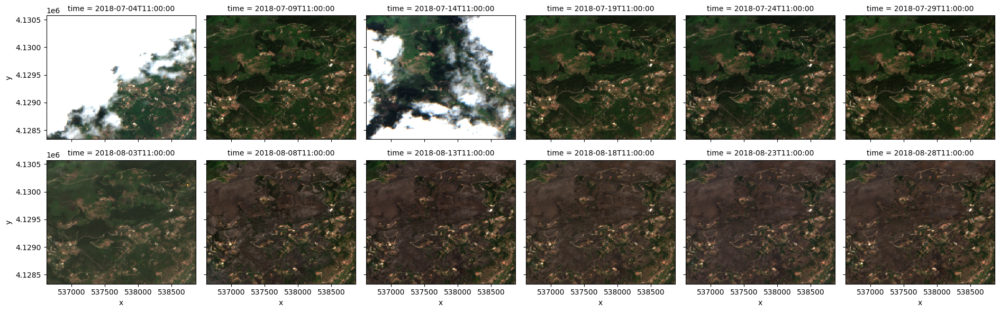

In [29]:
rgb = clipped_data.sel(band=["red", "green", "blue"])
rgb.plot.imshow(
    row="time", rgb="band", vmin=0, vmax=3000, col_wrap=6, cmap="terrain"
)

This time, use a 3-frame time series of non-cloudy scenes before/after fire.

In [19]:
PRITHVI_MODEL_VARIANT = "prithvi_vit_100"
DATASET_PATH = "/scratch/wildfire_before_after"
before_image = clipped_data.isel(time=[3,4,5])
after_image = clipped_data.isel(time=[-3,-2,-1])

In [21]:
before_image = drop_coords(before_image)
after_image = drop_coords(after_image)
labelled_before = concat_band(before_image, np.zeros(np.expand_dims(before_image[:,0,:,:], 1).shape), band_names=["label"], dims=["time","band","x","y"])
save_to_zarr(labelled_before, UPath(DATASET_PATH).joinpath("before.zarr"))
labelled_after = concat_band(after_image, np.ones(np.expand_dims(after_image[:,0,:,:],1).shape), band_names=["label"], dims=["time","band","x","y"])
save_to_zarr(labelled_after, UPath(DATASET_PATH).joinpath("after.zarr"))

In [23]:
model, config = get_prithvi_model(prithvi_model_variant=PRITHVI_MODEL_VARIANT, num_frames=3)
model

PrithviViT(
  (patch_embed): PatchEmbed(
    (proj): Conv3d(6, 768, kernel_size=(1, 16, 16), stride=(1, 16, 16))
    (norm): Identity()
  )
  (blocks): ModuleList(
    (0-11): 12 x Block(
      (norm1): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
      (attn): Attention(
        (qkv): Linear(in_features=768, out_features=2304, bias=True)
        (q_norm): Identity()
        (k_norm): Identity()
        (attn_drop): Dropout(p=0.0, inplace=False)
        (proj): Linear(in_features=768, out_features=768, bias=True)
        (proj_drop): Dropout(p=0.0, inplace=False)
      )
      (ls1): Identity()
      (drop_path1): Identity()
      (norm2): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
      (mlp): Mlp(
        (fc1): Linear(in_features=768, out_features=3072, bias=True)
        (act): GELU(approximate='none')
        (drop1): Dropout(p=0.0, inplace=False)
        (norm): Identity()
        (fc2): Linear(in_features=3072, out_features=768, bias=True)
        (drop2): D

In [24]:
dataset = PrithviDataset(
    chip_dir=DATASET_PATH,
    metadata=Box(metadata)
)
dataloader = DataLoader(
    dataset,
    batch_size=1,
    shuffle=False,
)

Found 2 chips to process for /scratch/wildfire_before_after


In [25]:
outputs = []
for sample in dataloader:
    y = sample.pop("mask")
    sample.pop("temporal_coords")
    sample.pop("location_coords")
    x = sample
    print(f"Max: {x['x'].max()}")
    print(f"Max: {x['x'].min()}")
    out = model.forward(**x)
    outputs.append(out[-1].squeeze()) # Last output is the final (normalised) one

Max: 3.4496145248413086
Max: -1.1792534589767456
Max: 2.972377061843872
Max: -1.425227403640747


In [26]:
scaler = StandardScaler()
scaled_data = scaler.fit_transform(np.concatenate([o.detach().numpy() for o in outputs]))
pca = PCA(n_components=3)
pca_result = pca.fit_transform(scaled_data)
pca_result.shape

(1178, 3)

In [27]:
df = pd.DataFrame({
    "1st Eigenvector": pca_result[:,0],
    "2nd Eigenvector": pca_result[:,1],
    "3rd Eigenvector": pca_result[:,2],
    "Before/After": ["none" for _ in range(pca_result.shape[0])],
    "Size": np.full(pca_result[:,0].shape, 2.5)
})

for i in range(pca_result.shape[0]):
    if i < np.ceil(pca_result.shape[0]/2).astype(int):
        df["Before/After"][i] = "Before"
    else:
        df["Before/After"][i] = "After"
        
fig = px.scatter_3d(df, x="2nd Eigenvector", y="1st Eigenvector", z="3rd Eigenvector",
            color="Before/After", size="Size")
fig.show()

/tmp/ipykernel_91703/3870108881.py:11: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_91703/3870108881.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



#### 3. Analyze the Embedding Space Representations for Before/After Wildfire with Cloud.

In [28]:
PRITHVI_MODEL_VARIANT = "prithvi_vit_100"
DATASET_PATH = "/scratch/wildfire_with_cloud"
before_image = clipped_data[:6]
after_image = clipped_data[6:]

In [29]:
before_image = drop_coords(before_image)
after_image = drop_coords(after_image)
labelled_before = concat_band(before_image, np.zeros(np.expand_dims(before_image[:,0,:,:], 1).shape), band_names=["label"], dims=["time","band","x","y"])
save_to_zarr(labelled_before, UPath(DATASET_PATH).joinpath("before.zarr"))
labelled_after = concat_band(after_image, np.ones(np.expand_dims(after_image[:,0,:,:],1).shape), band_names=["label"], dims=["time","band","x","y"])
save_to_zarr(labelled_after, UPath(DATASET_PATH).joinpath("after.zarr"))

In [30]:
model, config = get_prithvi_model(prithvi_model_variant=PRITHVI_MODEL_VARIANT, num_frames=6)
model

PrithviViT(
  (patch_embed): PatchEmbed(
    (proj): Conv3d(6, 768, kernel_size=(1, 16, 16), stride=(1, 16, 16))
    (norm): Identity()
  )
  (blocks): ModuleList(
    (0-11): 12 x Block(
      (norm1): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
      (attn): Attention(
        (qkv): Linear(in_features=768, out_features=2304, bias=True)
        (q_norm): Identity()
        (k_norm): Identity()
        (attn_drop): Dropout(p=0.0, inplace=False)
        (proj): Linear(in_features=768, out_features=768, bias=True)
        (proj_drop): Dropout(p=0.0, inplace=False)
      )
      (ls1): Identity()
      (drop_path1): Identity()
      (norm2): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
      (mlp): Mlp(
        (fc1): Linear(in_features=768, out_features=3072, bias=True)
        (act): GELU(approximate='none')
        (drop1): Dropout(p=0.0, inplace=False)
        (norm): Identity()
        (fc2): Linear(in_features=3072, out_features=768, bias=True)
        (drop2): D

In [31]:
dataset = PrithviDataset(
    chip_dir=DATASET_PATH,
    metadata=Box(metadata)
)
dataloader = DataLoader(
    dataset,
    batch_size=1,
    shuffle=False,
)

Found 2 chips to process for /scratch/wildfire_with_cloud


In [32]:
outputs = []
for sample in dataloader:
    y = sample.pop("mask")
    sample.pop("temporal_coords")
    sample.pop("location_coords")
    x = sample
    print(f"Max: {x['x'].max()}")
    print(f"Max: {x['x'].min()}")
    out = model.forward(**x)
    outputs.append(out[-1].squeeze()) # Last output is the final (normalised) one

Max: 9.845114707946777
Max: -1.452541708946228
Max: 11.538150787353516
Max: -1.4486132860183716


In [33]:
scaler = StandardScaler()
scaled_data = scaler.fit_transform(np.concatenate([o.detach().numpy() for o in outputs]))
pca = PCA(n_components=3)
pca_result = pca.fit_transform(scaled_data)
pca_result.shape

(2354, 3)

In [34]:
df = pd.DataFrame({
    "1st Eigenvector": pca_result[:,0],
    "2nd Eigenvector": pca_result[:,1],
    "3rd Eigenvector": pca_result[:,2],
    "Before/After": ["none" for _ in range(pca_result.shape[0])],
    "Size": np.full(pca_result[:,0].shape, 2.5)
})

for i in range(pca_result.shape[0]):
    if i < np.ceil(pca_result.shape[0]/2).astype(int):
        df["Before/After"][i] = "Before"
    else:
        df["Before/After"][i] = "After"
        
fig = px.scatter_3d(df, x="2nd Eigenvector", y="1st Eigenvector", z="3rd Eigenvector",
            color="Before/After", size="Size")
fig.show()

/tmp/ipykernel_91703/3870108881.py:11: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_91703/3870108881.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

